In [38]:
# ------------All libraries use din this notebook-------------------------------
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.preprocessing import OneHotEncoder,LabelBinarizer
from sklearn.model_selection import train_test_split, cross_val_score, KFold
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import LabelEncoder
from factor_analyzer import FactorAnalyzer
from sklearn.model_selection import cross_val_predict
import seaborn as sns
from scipy.stats import f_oneway
import scipy.stats as stats
from sklearn.metrics import classification_report, accuracy_score, roc_auc_score, roc_curve, auc
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report

In [39]:
#-------------------------- Reading Data from my Local repository----------------------------
""" -------------------Datatset Details------------------------------------
    Dataset Name:Cirrhosis Patient Survival Prediction
    URL: https://archive.ics.uci.edu/dataset/878/cirrhosis+patient+survival+prediction+dataset-1
    Domain: Health and Medicine
    Instances: 418
    Features: 17
    Feature Type: Real, Categorical
    Target Variable: Status

"""
def Data_Load():
    df = pd.read_csv('../Datasets/cirrhosis.csv')
    
    return df

In [40]:
# ---In this function i have write code for remove missing values, data entry errors, unnecessary columns, and rows etc
# I found some missing values in my dataset and i impute them in such a way that numerical columns with median and cateogical values with mode. 
#      however there are some rows that need to be deleted like 'Platelets', 'Prothrombin', and 'Stage' columns
def Data_Cleaning(df):
    numerical_cols = ['Cholesterol', 'Copper', 'Alk_Phos', 'SGOT', 'Tryglicerides', 'Platelets', 'Prothrombin']
    df[numerical_cols] = df[numerical_cols].fillna(df[numerical_cols].median())

    categorical_cols = ['Drug', 'Ascites', 'Hepatomegaly', 'Spiders']
    df[categorical_cols] = df[categorical_cols].fillna(df[categorical_cols].mode().iloc[0])

    df = df.dropna(subset=['Platelets', 'Prothrombin', 'Stage'])

    return df

In [41]:
# In this fucntion i performed data transformation where i change feature name like Number of Days
def data_transformation(df):
    df = df.rename(columns={'N_Days': 'Number_of_Days'})
    return df

In [42]:
# ----------One-hot encoding, it is used to convert categorical variables into numerical values... in my dataset i have Drug featyre of cateogry types so i have to change it----------------------
def OneHotEncode(df):
    categorical_cols = ['Sex', 'Ascites', 'Hepatomegaly', 'Spiders', 'Edema', 'Drug']
    encoder = OneHotEncoder(drop='first', sparse=False)
    encoded_cols = pd.DataFrame(encoder.fit_transform(df[categorical_cols]))
    df_encoded = pd.concat([df.drop(columns=categorical_cols), encoded_cols], axis=1)
    df_encoded2  = df_encoded.dropna()
    return df_encoded2



In [43]:
# ---------------------------------------- EDA Explaination----------------------------------------------------
"""1- Descriptive Statistics: It provide a summary of the main characteristics of a dataset. For Example in given dataset there are some features that i ahve to analyze:
        For example for age variable, Mean shows the average age of the patients.Standard Deviation shows spread of ages around the mean. Similarly,Min and Max shows the youngest and oldest patients ages.
Quartiles (Q1, Q2, Q3) divide the age in dataset into four equal parts. """

"""2- Using inferential Statisitcs i performed T-Test for relationship between certain variables like there is a difference in age between patients with different types of drugs"""

"""3-Covariance & Correlation Matrix: In results, positive covariance indicates that as one variable increases, the other variable also tends to increase, and vice versa. I also created correlation it mean correlation of 1 indicates a perfect positive linear relationship,-1 indicates a perfect negative linear relationship, and 0 indicates no linear relationship. I also make correlation Heatmap once we run fun ction we can see it and where we can see clearly the results of it and relationship between variables. """

"""4- I also draw histograms and box plots for variables. Histograms provide insights into the central tendency,variability, and shape of the distribution. It help identify patterns such as skewness etc.
 Box pLots provides five number summary where we can see plot and we can determine outliers etc
 For exmaple: A histogram of ages can help understand the distribution of ages in given dataset, which is important for analyzing the demographics of cirrhosis patients.
 Similary using box plot, a boxplot of age can show the central tendency and spread of ages in dataset, highlighting any potential outliers or unusual patterns in dataset."""

"""5- I also used Distribution of some variables like 'Status', 'Sex', 'Ascites', 'Hepatomegaly', 'Spiders', 'Edema', and 'Drug'. Creating distribution plots for these variables can provide insights into the frequency of different categories within each variable."""

"5- I also used Distribution of some variables like 'Status', 'Sex', 'Ascites', 'Hepatomegaly', 'Spiders', 'Edema', and 'Drug'. Creating distribution plots for these variables can provide insights into the frequency of different categories within each variable."

In [44]:
# in this function, i performed EDA where i have Desrciptive statistics,Inferential statistic, Covariance,Correlations, Heatmap,Histograms and Boxplots for numerical variables, Distribution plots for categorical variables
def EDA(df):
    # Drop rows with non-numeric values in 'Age' column
    df = df[pd.to_numeric(df['Age'], errors='coerce').notnull()]

    descriptive_stats = df.describe()

    age = df['Age']
    age_mean = age.mean()
    t_stat, p_value = stats.ttest_1samp(age, popmean=age_mean)
    print(f"T-statistic: {t_stat}")
    print(f"P-value: {p_value}")
    
    covariance_matrix = df.cov()

    correlation_matrix = df.corr()

    # Correlation Heatmap
    plt.figure(figsize=(12, 8))
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
    plt.title('Correlation Heatmap')
    plt.show()

    # Histograms and Boxplots for numerical variables
    numeric_columns = df.select_dtypes(include=['float64', 'int64']).columns
    for column in numeric_columns:
        column_mean = df[column].mean()
        column_mode = df[column].mode().values[0] 
        column_median = df[column].median()
        column_q1 = df[column].quantile(0.25)
        column_q3 = df[column].quantile(0.75)

        print(f"--- {column} ---")
        print(f"Mean: {column_mean}")
        print(f"Mode: {column_mode}")
        print(f"Median: {column_median}")
        print(f"Q1: {column_q1}")
        print(f"Q3: {column_q3}")

        # Histogram
        plt.figure(figsize=(8, 6))
        sns.histplot(df[column], kde=True)
        plt.title(f'Histogram of {column}')
        plt.show()
        
        # Display pairplot for numerical columns
        numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns
        sns.pairplot(df[numerical_cols])
        plt.title('Pairplot of Numerical Columns')
        plt.show()
        
        # Boxplot
        plt.figure(figsize=(8, 6))
        sns.boxplot(x=df[column])
        plt.title(f'Boxplot of {column}')
        plt.show()
    
    # Distribution plots for categorical variables
    categorical_columns = df.select_dtypes(include=['object', 'category']).columns
    for column in categorical_columns:
        plt.figure(figsize=(8, 6))
        sns.countplot(data=df, x=column)
        plt.title(f'Distribution of {column}')
        plt.show()

    return descriptive_stats, t_stat, p_value, covariance_matrix, correlation_matrix

In [45]:
"""box plot for each numerical column identify any data points that fall outside the whiskers of the box plot, indicating potential outliers"""
def  Detecting_outliers_Anomalies(df):
    numerical_columns = ['N_Days', 'Age', 'Bilirubin', 'Cholesterol', 'Albumin', 'Copper', 'Alk_Phos', 'SGOT', 'Tryglicerides', 'Platelets', 'Prothrombin']

    #----------------box plots for each numerical column---------------------------
    for column in numerical_columns:
        plt.figure(figsize=(8, 5))
        plt.boxplot(df[column], vert=False)
        plt.xlabel(column)
        plt.title(f'Boxplot of {column}')
        plt.show()

In [46]:
# we'll implement it once we done it in class
def Feature_Selection(df):
    return;

In [47]:
# we'll implement it once we done it in class
def Dimention_Reduction(df):
    return;

In [48]:
#------------------------------Splitting Data using Manual way-----------------------------
def manual_splitting(df, target_column, test_size=0.2, validation_size=0.2, random_state=42):
    X = df.drop(columns=[target_column])
    y = df[target_column]
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=random_state)
    X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=validation_size, random_state=random_state)

    return X_train, X_val, X_test, y_train, y_val, y_test

In [49]:
#------------------------------Splitting Data using Cross Validation-----------------------------
def cross_validation(df, target_column, k=3, cv=5, random_state=42):
    X = df.drop(columns=[target_column])
    y = df[target_column]
    knn = KNeighborsClassifier(n_neighbors=k)
    scores = cross_val_score(knn, X, y, cv=cv, scoring='accuracy')

    return scores.mean()

In [50]:
# ----------I select Model KNeighborsClassifier and Trainign using both manual and CV ways and calculating accuracy
#-------------------------------Testing Manual splitting-------------------------------------
X_train, X_val, X_test, y_train, y_val, y_test = manual_splitting(OneHotEncode(Data_Cleaning(Data_Load())), 'Status')
knn = KNeighborsClassifier(n_neighbors=3)
knn.fit(X_train, y_train)
y_pred = knn.predict(X_test)
test_accuracy_manual = accuracy_score(y_test, y_pred)

# ---------------------cross-validation-----------------------
cv_accuracy = cross_validation(OneHotEncode(Data_Cleaning(Data_Load())), 'Status')

In [51]:
"""Here i evaluate the performance of a classification model using metrics:
    The model has an accuracy of approximately 65.85%, which means that it correctly predicts the class label for about 65.85% of the samples.
    Precision, Recall, and F1-score: These metrics provide insights into the model's performance for each class:::
    Class 0: The model has a precision of 0.68, recall of 0.78 and F1-score of 0.73. This indicates that the model performs relatively well for this class, with a good balance between precision and recall.
    Class 1: The precision, recall, and F1-score for this class are all 0.00, which suggests that the model struggles to correctly classify samples belonging to this class. It may be underfitting or not capturing the patterns specific to this class.
    Class 2: The model has a precision of 0.67, recall of 0.56, and F1-score of 0.61 for this class. While the precision is decent, the recall indicates that the model misses a significant number of positive samples for this class.
    Support: Support indicates the number of samples for each class. Class 1 has the lowest support (only 4 samples), which could contribute to the lower performance metrics for this class.
    ROC-AUC Score: The ROC-AUC score is approximately 0.74, which suggests that the model performs reasonably well in terms of its ability to distinguish between classes.
"""
def classification_metrics(y_true, y_pred):
    label_encoder = LabelEncoder()
    y_true_encoded = label_encoder.fit_transform(y_true)
    y_pred_encoded = label_encoder.transform(y_pred)

    # Convert labels to binary format
    label_binarizer = LabelBinarizer()
    y_true_binary = label_binarizer.fit_transform(y_true_encoded)
    y_pred_binary = label_binarizer.transform(y_pred_encoded)

    accuracy = accuracy_score(y_true_encoded, y_pred_encoded)
    report = classification_report(y_true_encoded, y_pred_encoded)
    roc_auc = roc_auc_score(y_true_binary, y_pred_binary, average='macro')

    # Plot ROC curve
    fpr, tpr, _ = roc_curve(y_true_binary.ravel(), y_pred_binary.ravel())
    roc_auc = auc(fpr, tpr)

    plt.figure()
    plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic')
    plt.legend(loc='lower right')
    plt.show()
    return accuracy, report, roc_auc

In [52]:
"""--------------------Master function that execute all functions for KNN Classifier-------------------"""
def Master():
    # Calling function for loading the data
    df = Data_Load()

    # Calling function for data cleaning
    df_cleaned = Data_Cleaning(df)
    
     # Calling function for data transformation
    data_transformation(df)
    
    #  Calling function for data cleaning one-hot encoding
    df_encoded = OneHotEncode(df_cleaned)
    
      # Calling function for Exploratiry Data Analysis (EDA)
    EDA(df)
    
     # Calling function for Outliers Detection
    Detecting_outliers_Anomalies(df)
    
    # Calling function for feature Selection
    Feature_Selection(df)
    
    # Calling function for Dimension Reduction
    Dimention_Reduction(df)
    
    # Split the data using manual splitting
    X_train_manual, X_val_manual, X_test_manual, y_train_manual, y_val_manual, y_test_manual = manual_splitting(df_encoded, 'Status')

    # Train the model and get predictions for manual splitting
    knn = KNeighborsClassifier(n_neighbors=3)
    knn.fit(X_train_manual, y_train_manual)
    y_pred_manual = knn.predict(X_test_manual)

    # Get classification metrics for manual splitting
    accuracy_manual, report_manual, roc_auc_manual = classification_metrics(y_test_manual, y_pred_manual)

    # Get cross-validation accuracy
    cv_accuracy = cross_validation(df_encoded, 'Status')

    # Print the results for manual splitting
    print("Manual Splitting Test Accuracy:", accuracy_manual)
    print("Classification Report (Manual Splitting):")
    print(report_manual)
    print("ROC AUC (Manual Splitting):", roc_auc_manual)
    print()
    # Print the cross-validation accuracy
    print("Cross-Validation Mean Accuracy:", cv_accuracy)

T-statistic: 0.0
P-value: 1.0


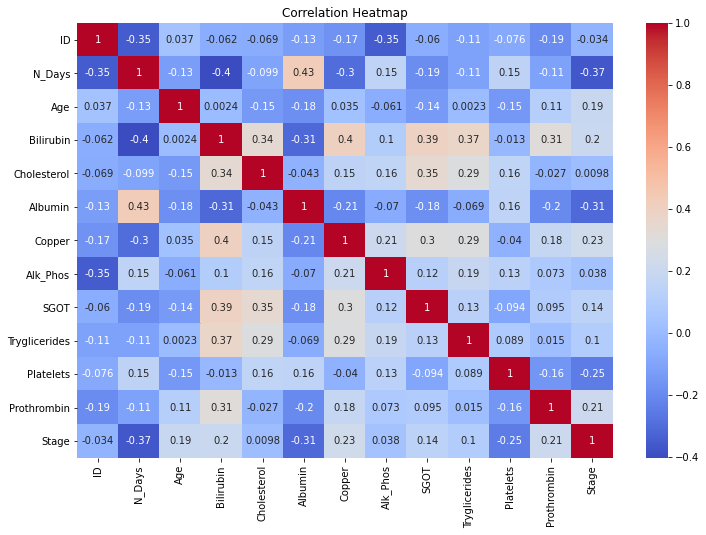

--- ID ---
Mean: 209.5
Mode: 1
Median: 209.5
Q1: 105.25
Q3: 313.75


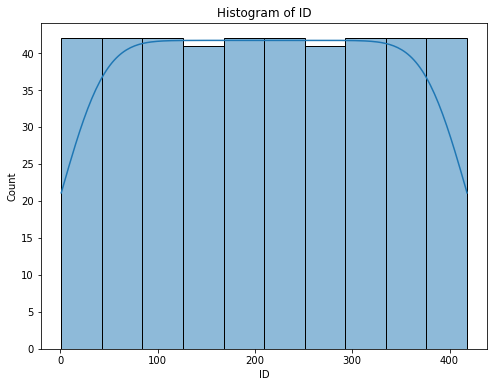

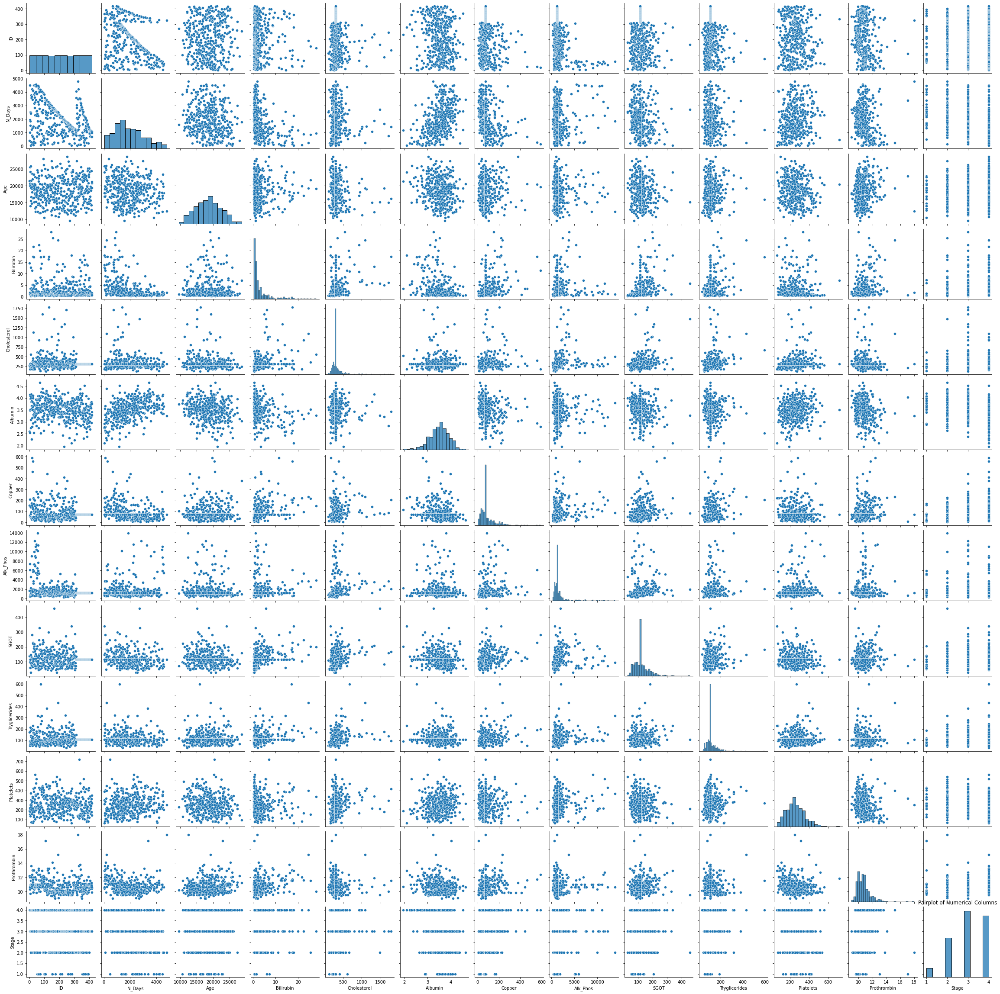

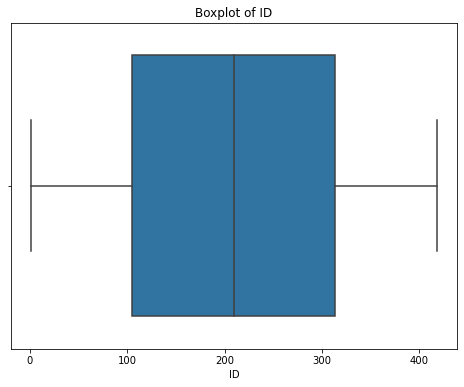

--- N_Days ---
Mean: 1917.7822966507176
Mode: 41
Median: 1730.0
Q1: 1092.75
Q3: 2613.5


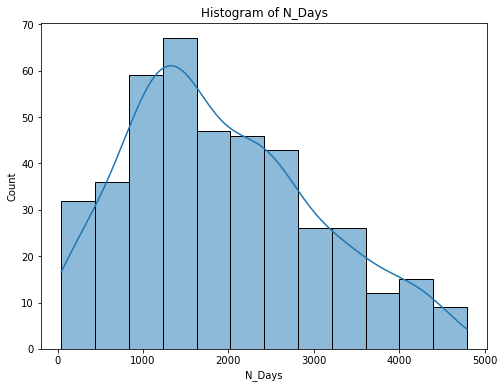

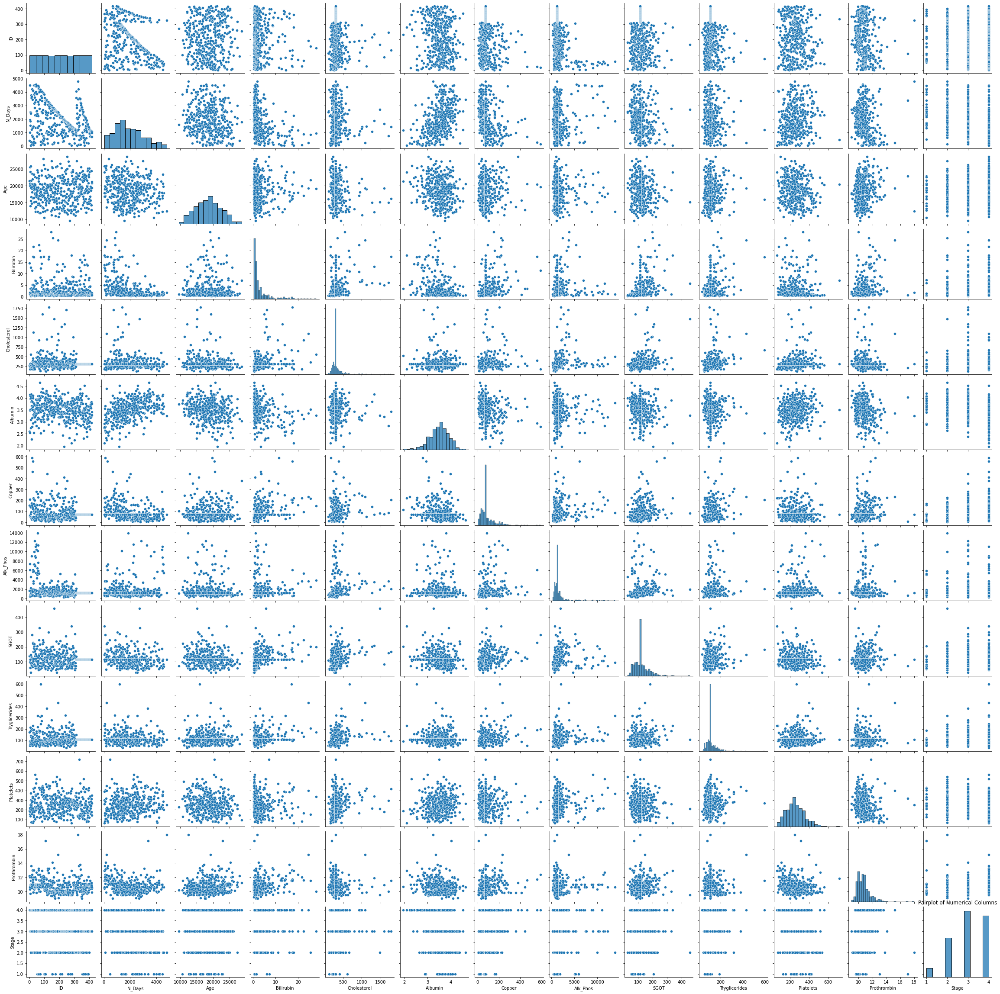

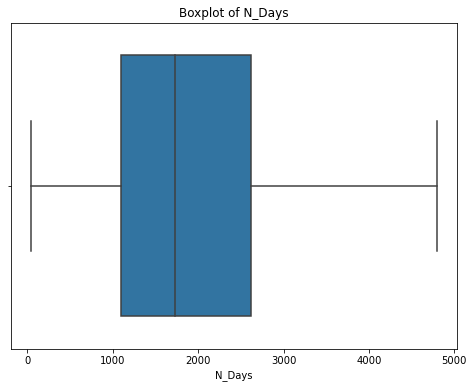

--- Age ---
Mean: 18533.351674641148
Mode: 19724
Median: 18628.0
Q1: 15644.5
Q3: 21272.5


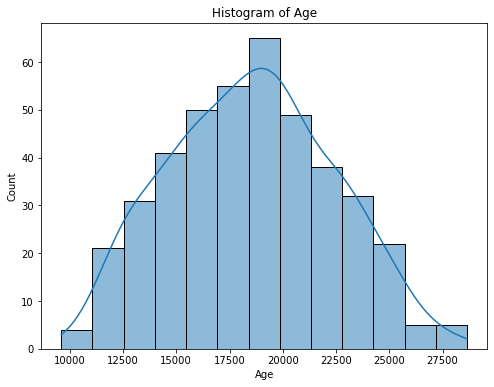

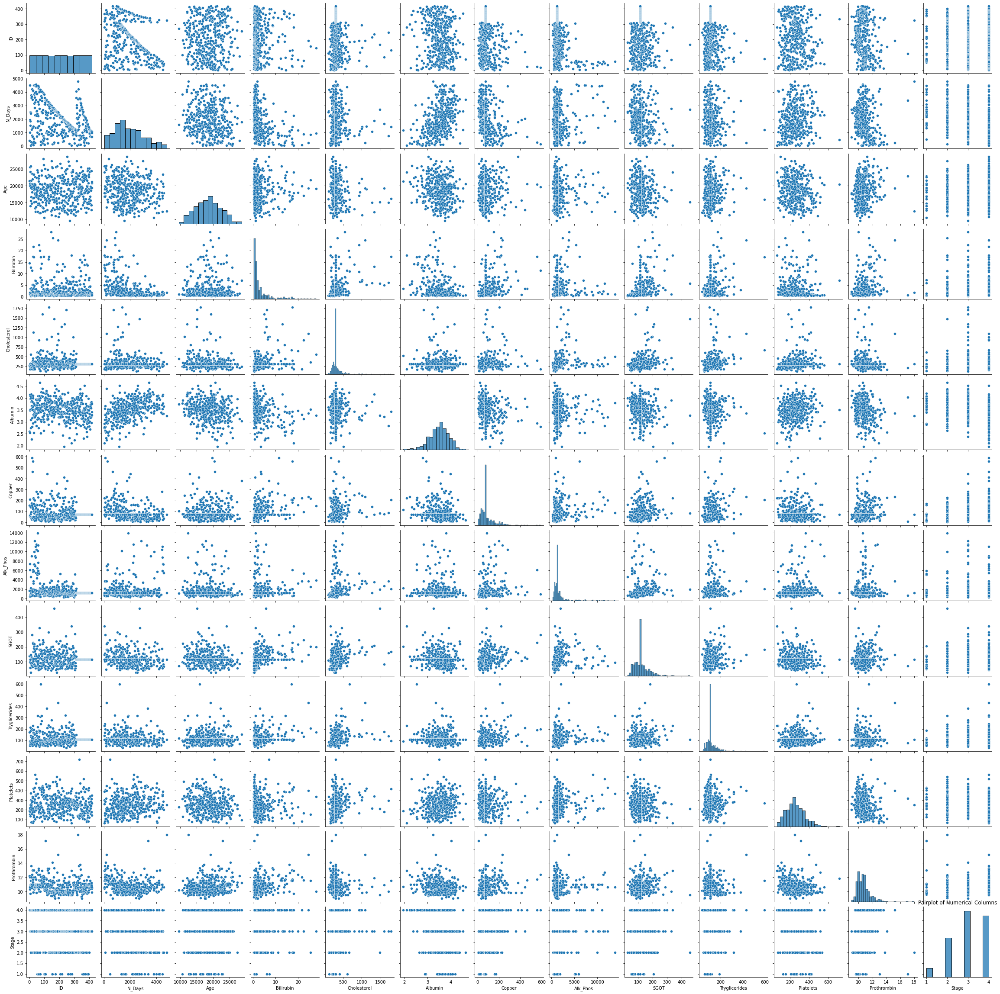

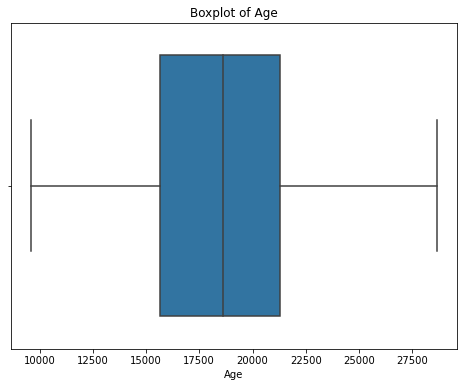

--- Bilirubin ---
Mean: 3.220813397129186
Mode: 0.7
Median: 1.4
Q1: 0.8
Q3: 3.4


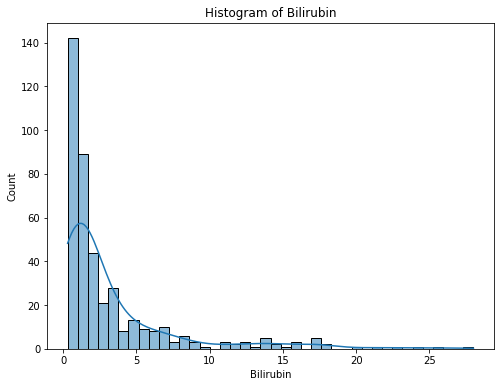

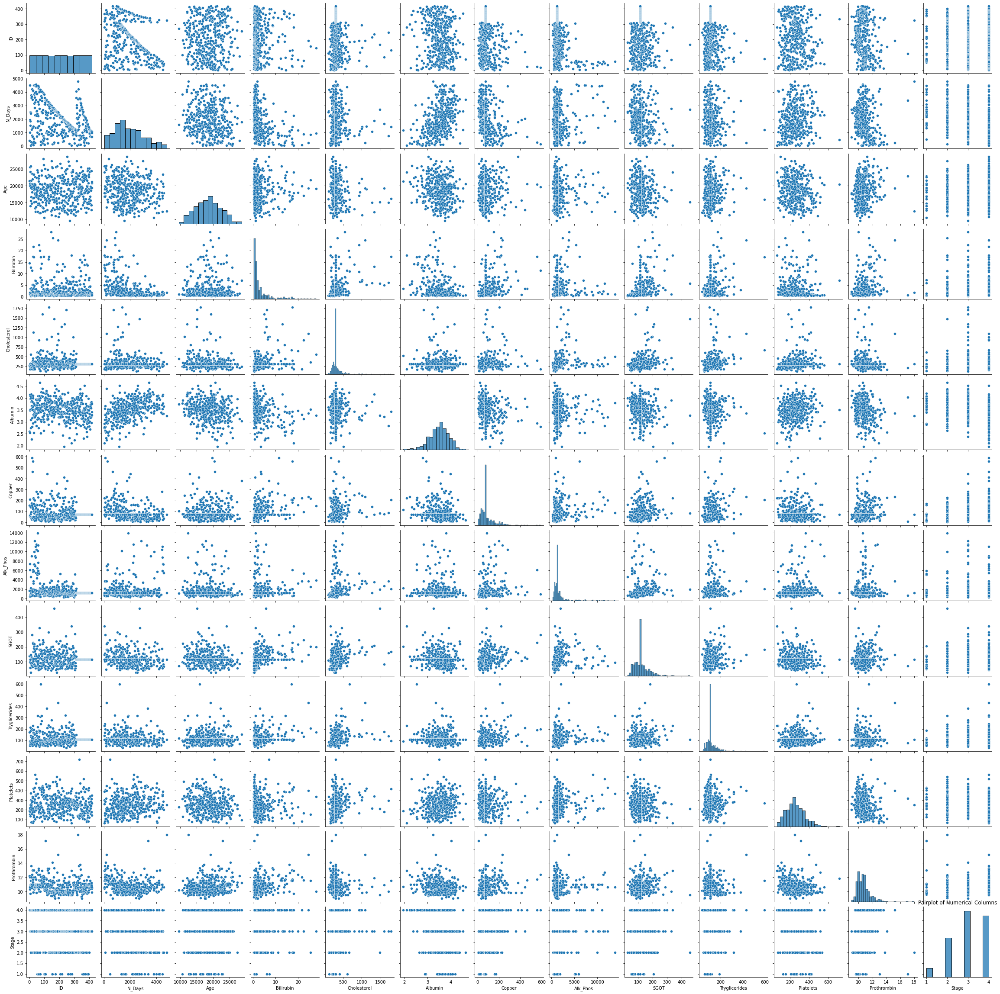

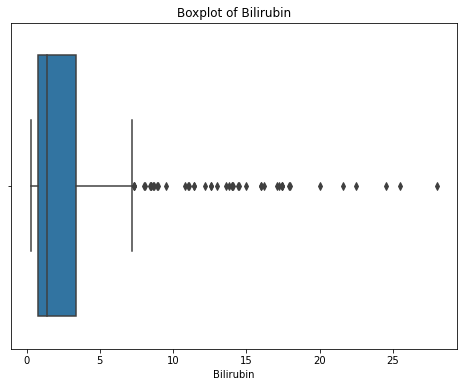

--- Cholesterol ---
Mean: 350.27272727272725
Mode: 309.5
Median: 309.5
Q1: 273.0
Q3: 347.75


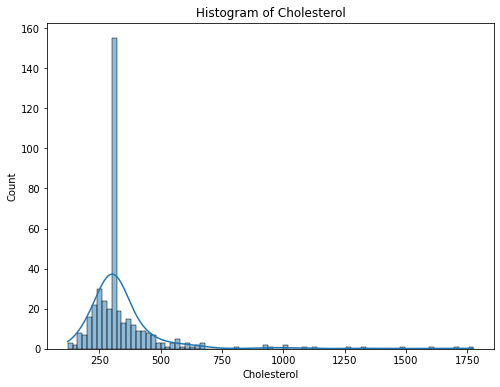

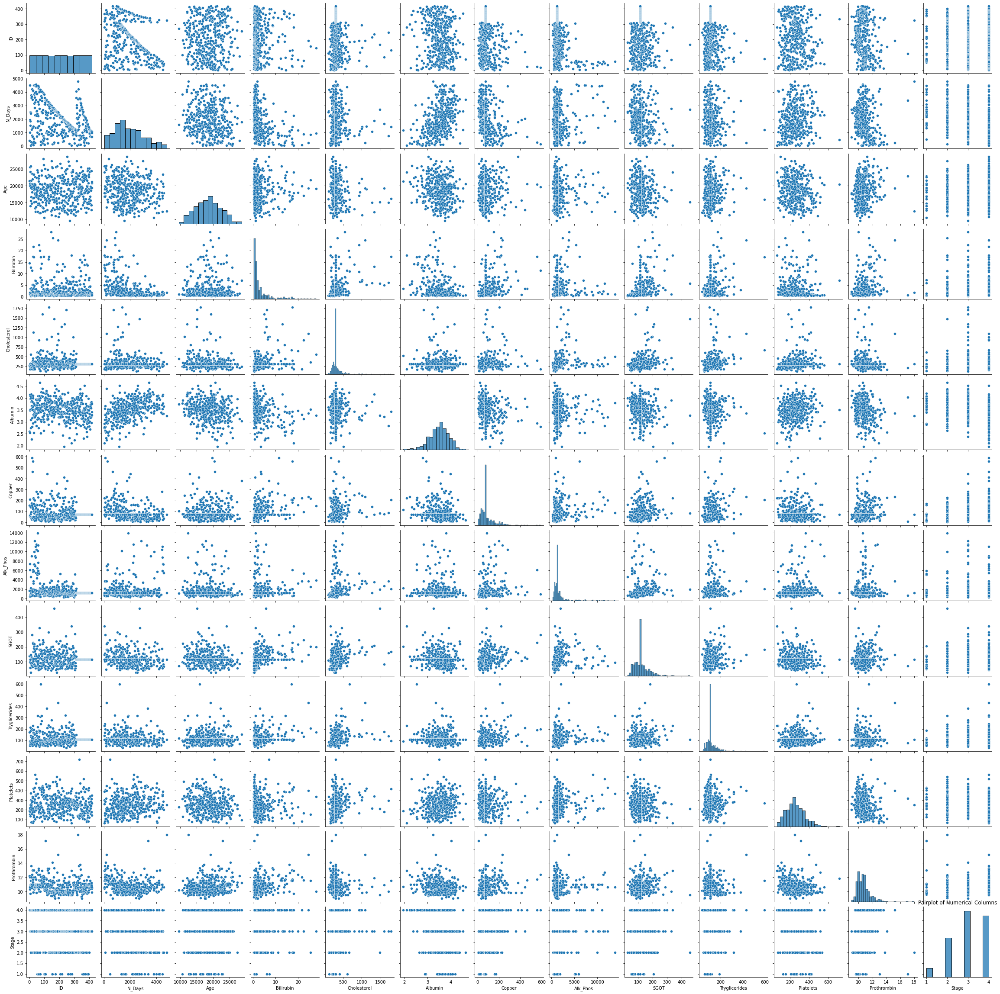

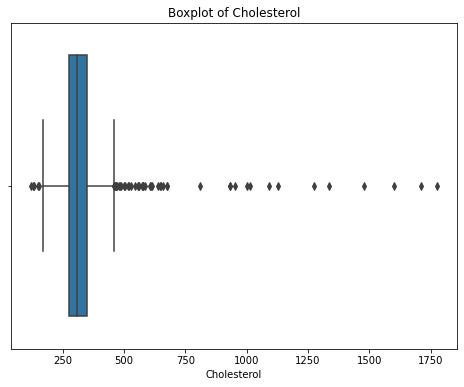

--- Albumin ---
Mean: 3.497440191387561
Mode: 3.35
Median: 3.53
Q1: 3.2425
Q3: 3.77


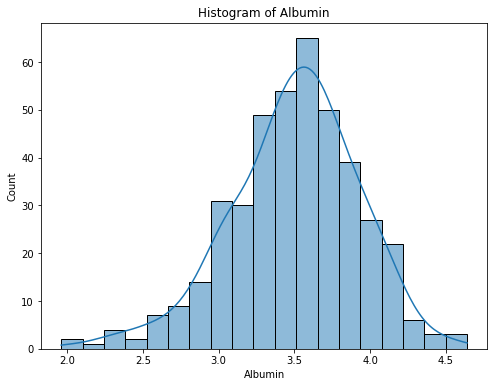

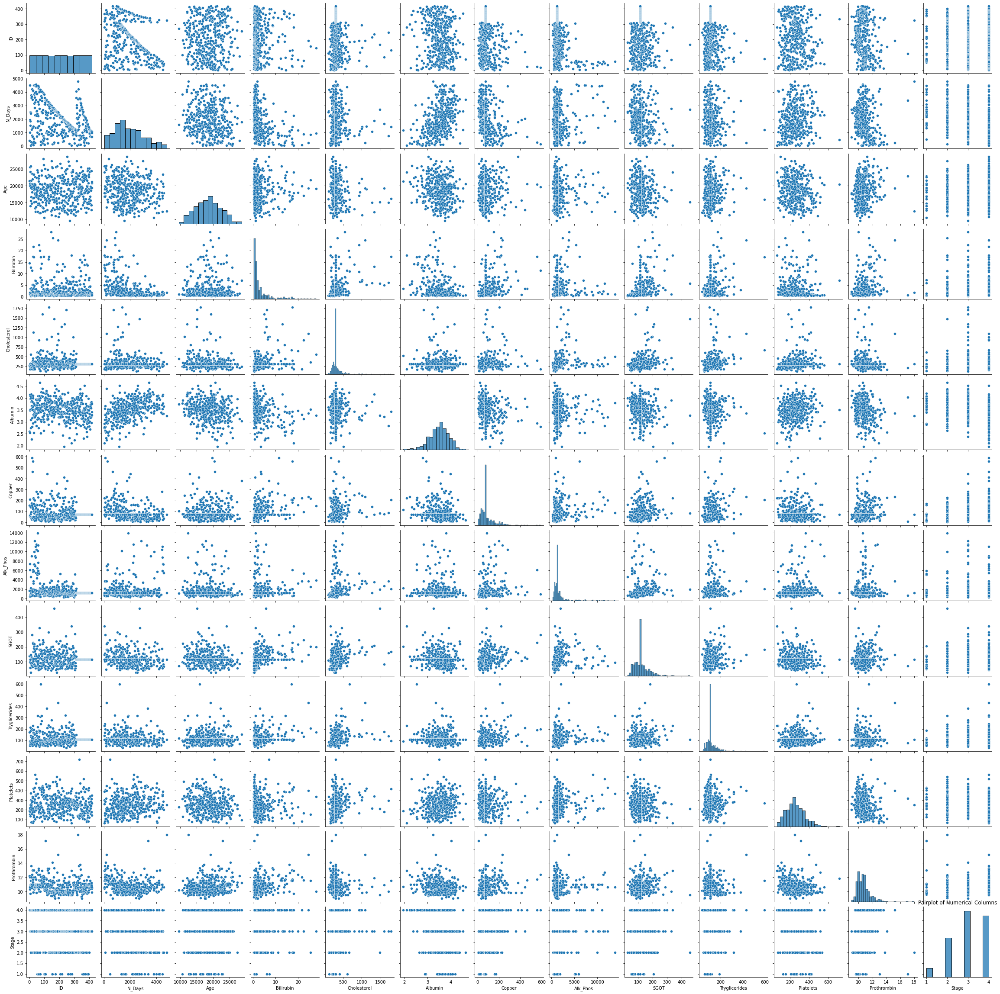

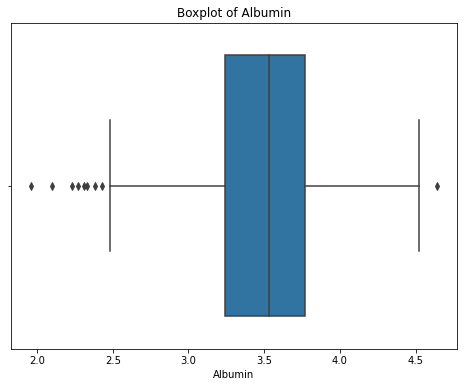

--- Copper ---
Mean: 91.27990430622009
Mode: 73.0
Median: 73.0
Q1: 51.25
Q3: 100.75


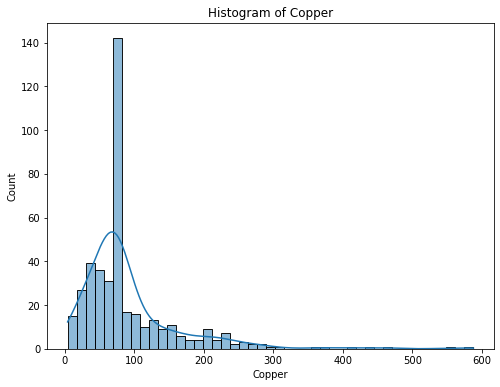

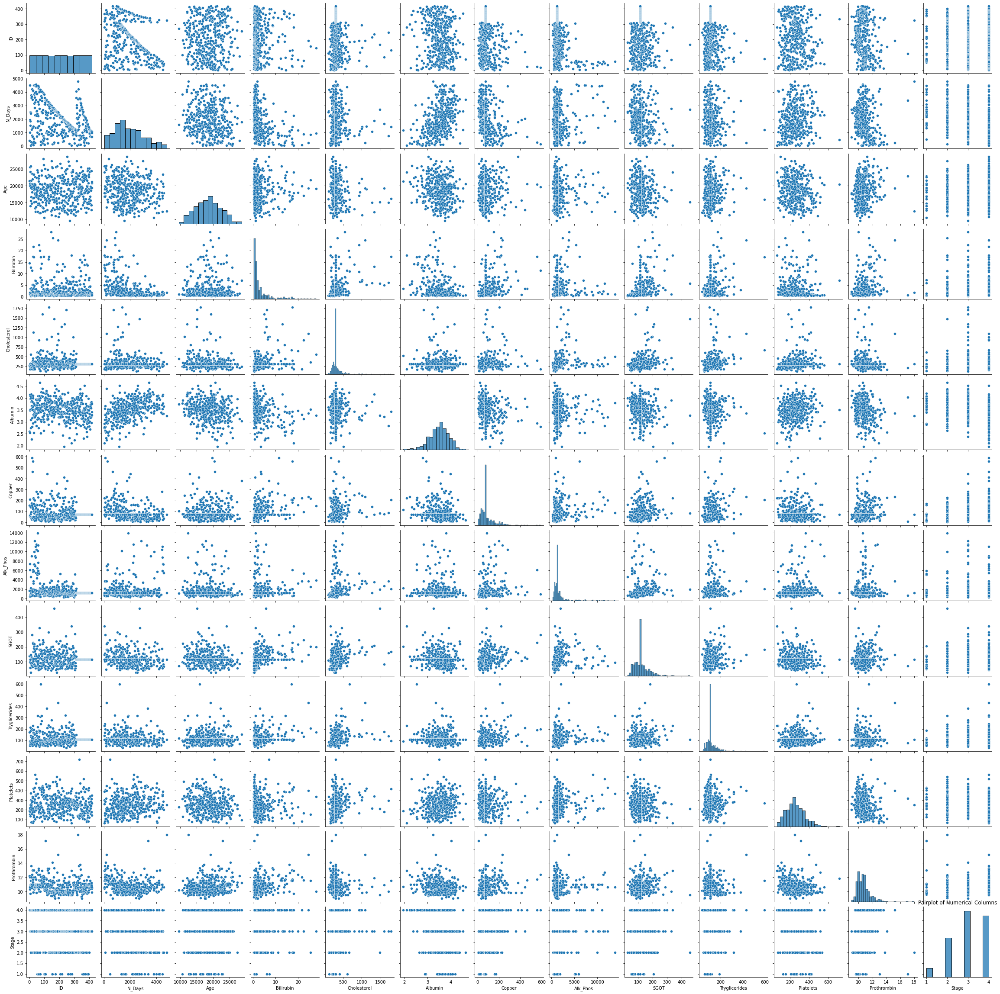

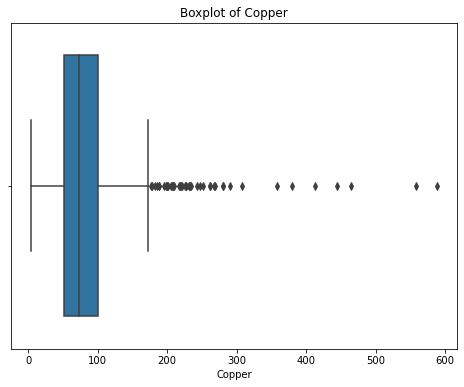

--- Alk_Phos ---
Mean: 1799.144976076555
Mode: 1259.0
Median: 1259.0
Q1: 1016.25
Q3: 1707.75


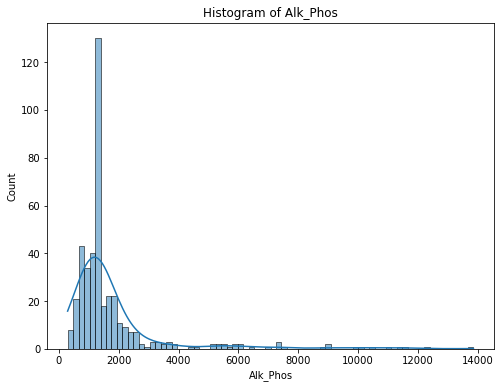

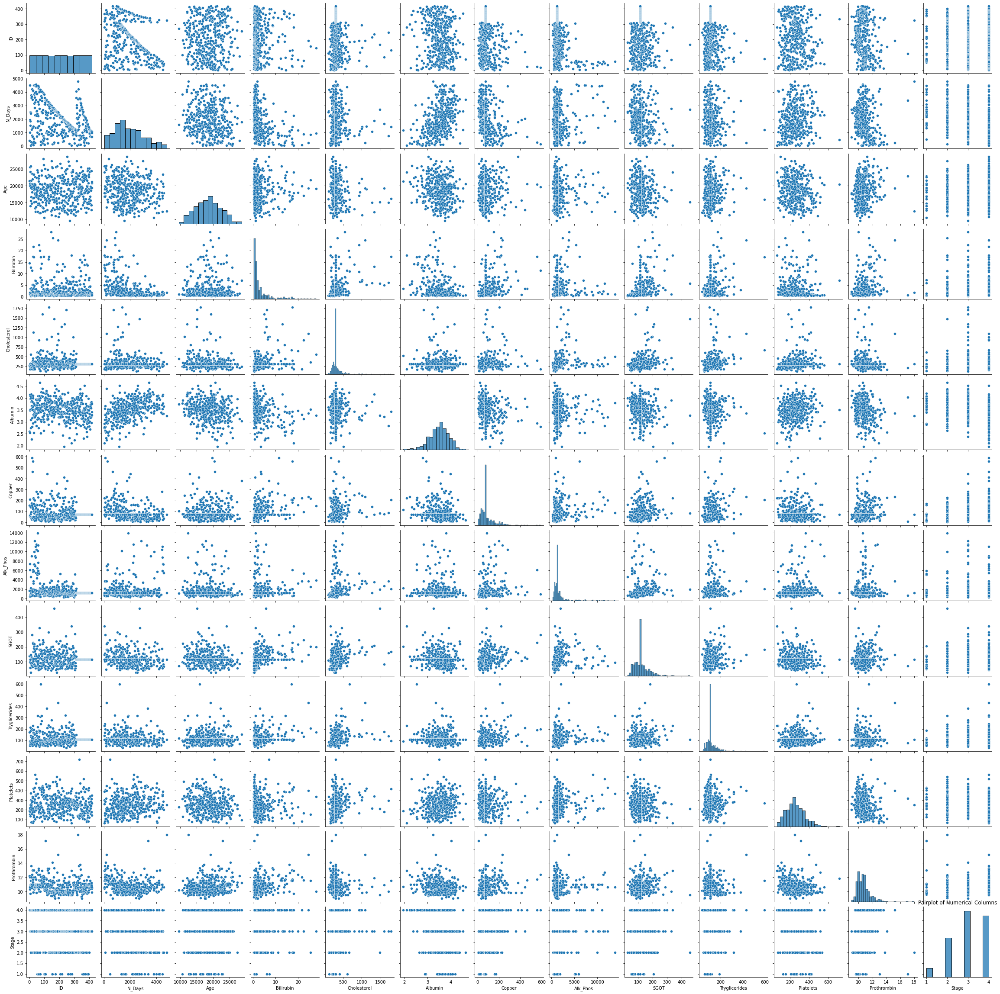

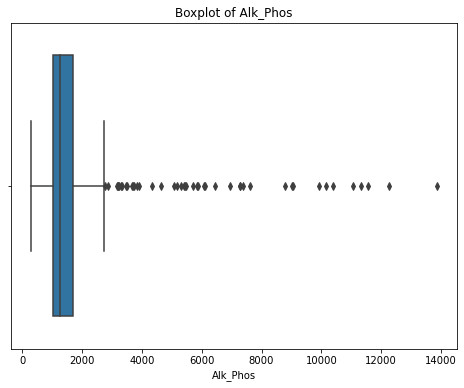

--- SGOT ---
Mean: 120.5640669856452
Mode: 114.7
Median: 114.7
Q1: 91.0
Q3: 135.75


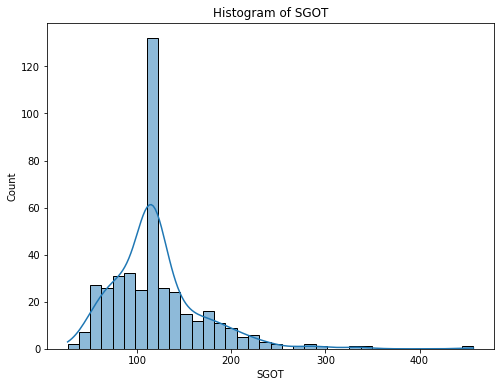

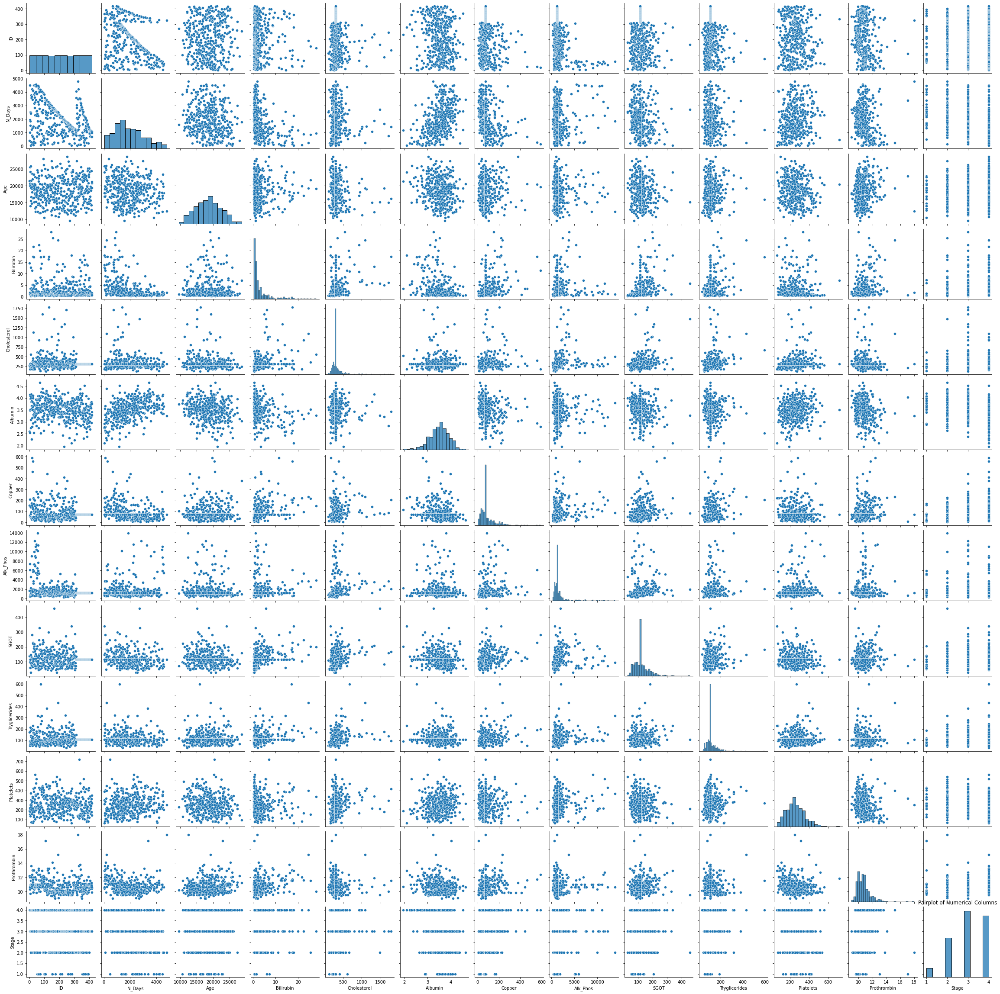

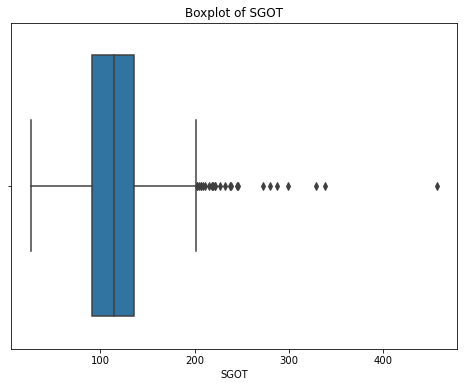

--- Tryglicerides ---
Mean: 119.26794258373205
Mode: 108.0
Median: 108.0
Q1: 95.0
Q3: 127.75


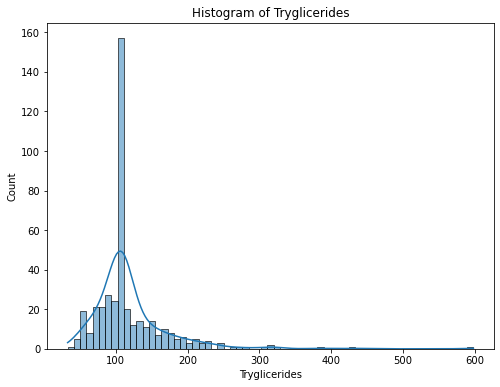

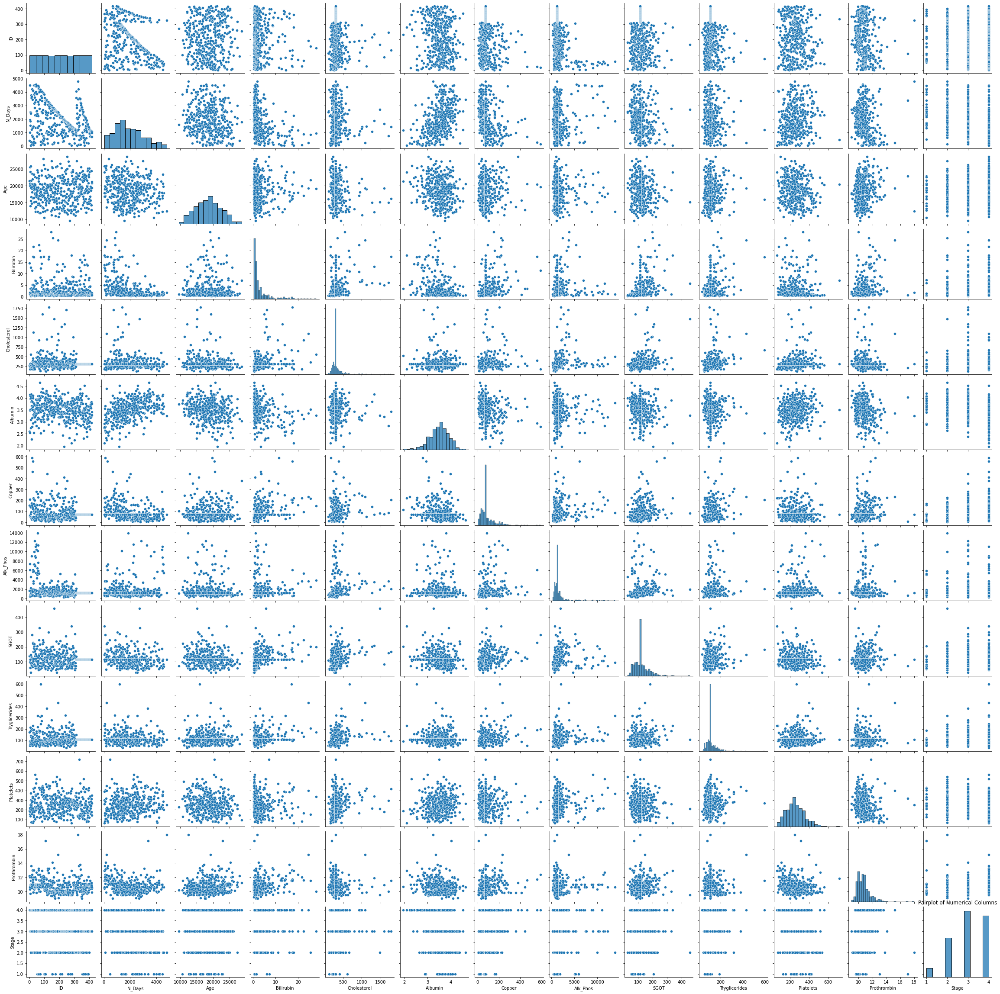

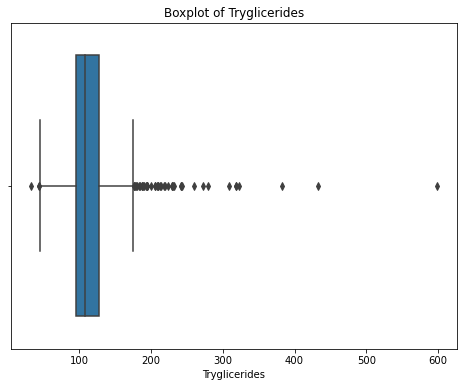

--- Platelets ---
Mean: 256.86602870813397
Mode: 251.0
Median: 251.0
Q1: 190.0
Q3: 315.5


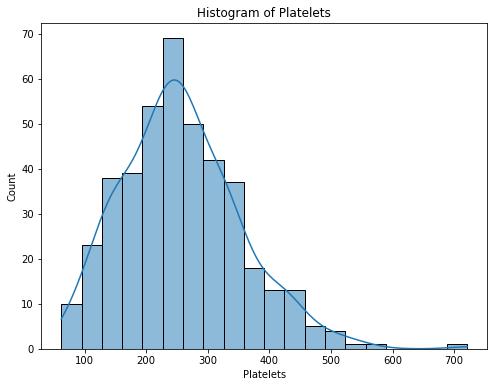

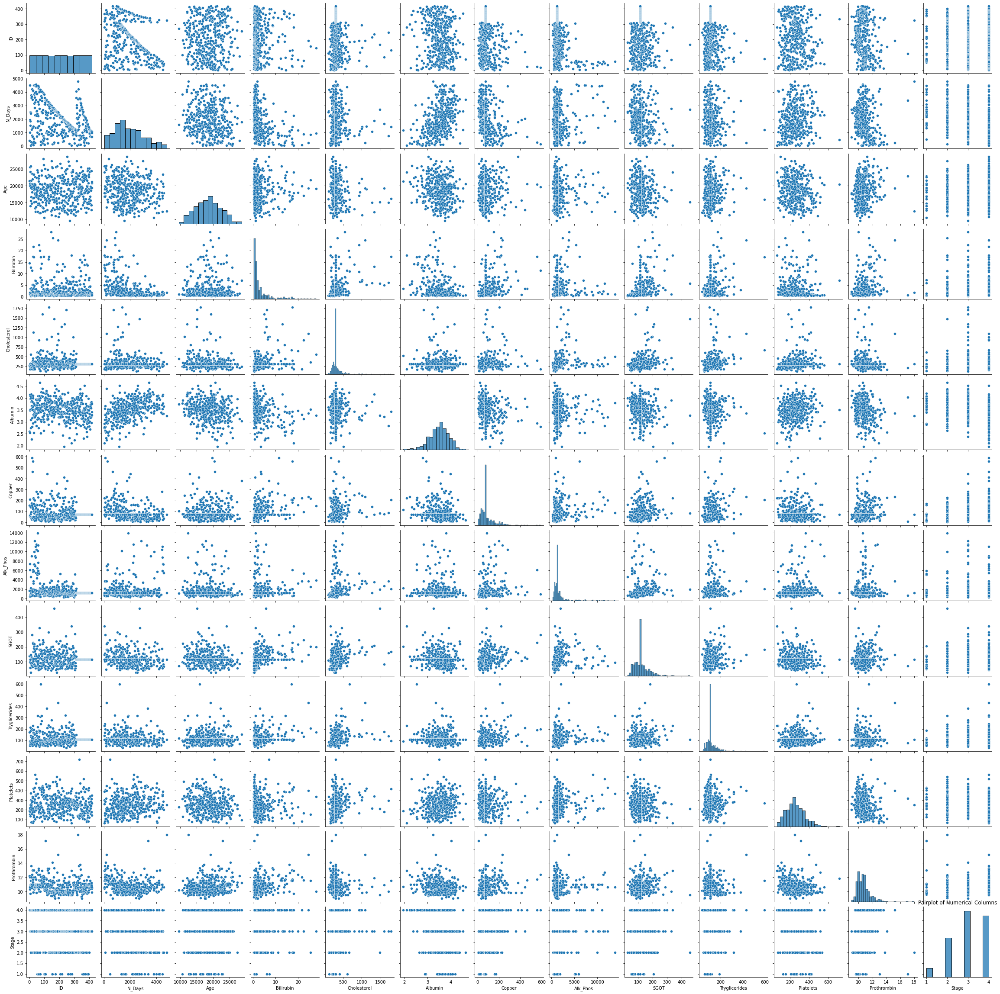

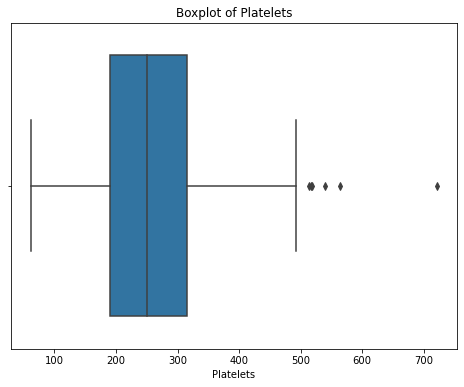

--- Prothrombin ---
Mean: 10.731100478468898
Mode: 10.6
Median: 10.6
Q1: 10.0
Q3: 11.1


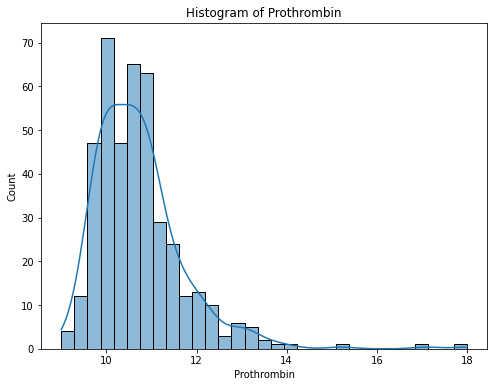

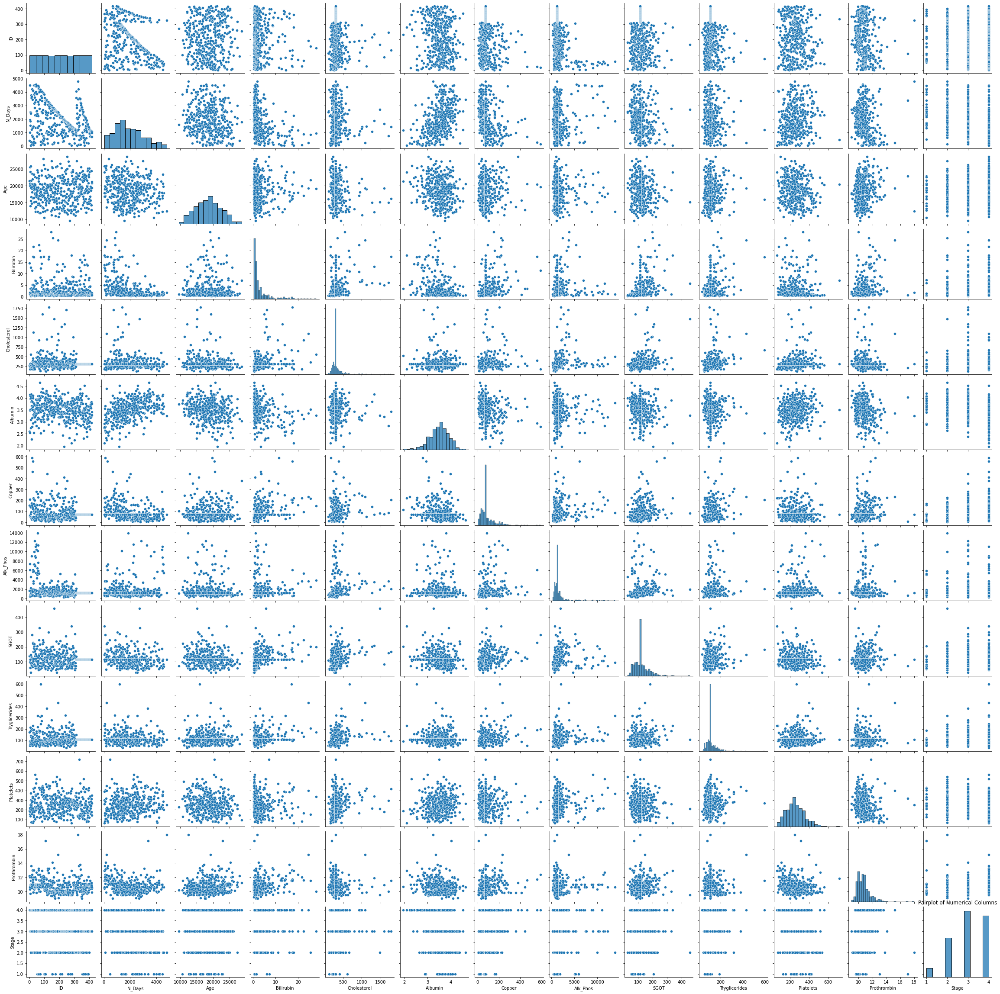

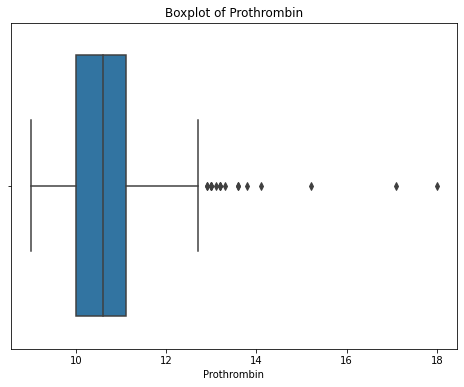

--- Stage ---
Mean: 3.0242718446601944
Mode: 3.0
Median: 3.0
Q1: 2.0
Q3: 4.0


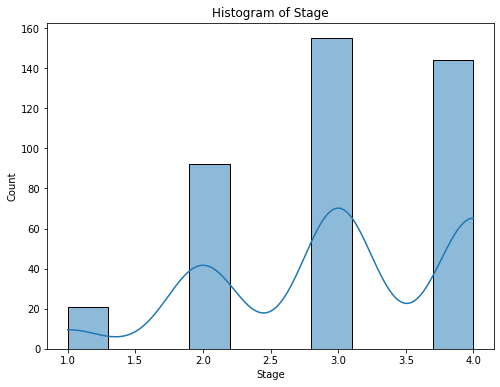

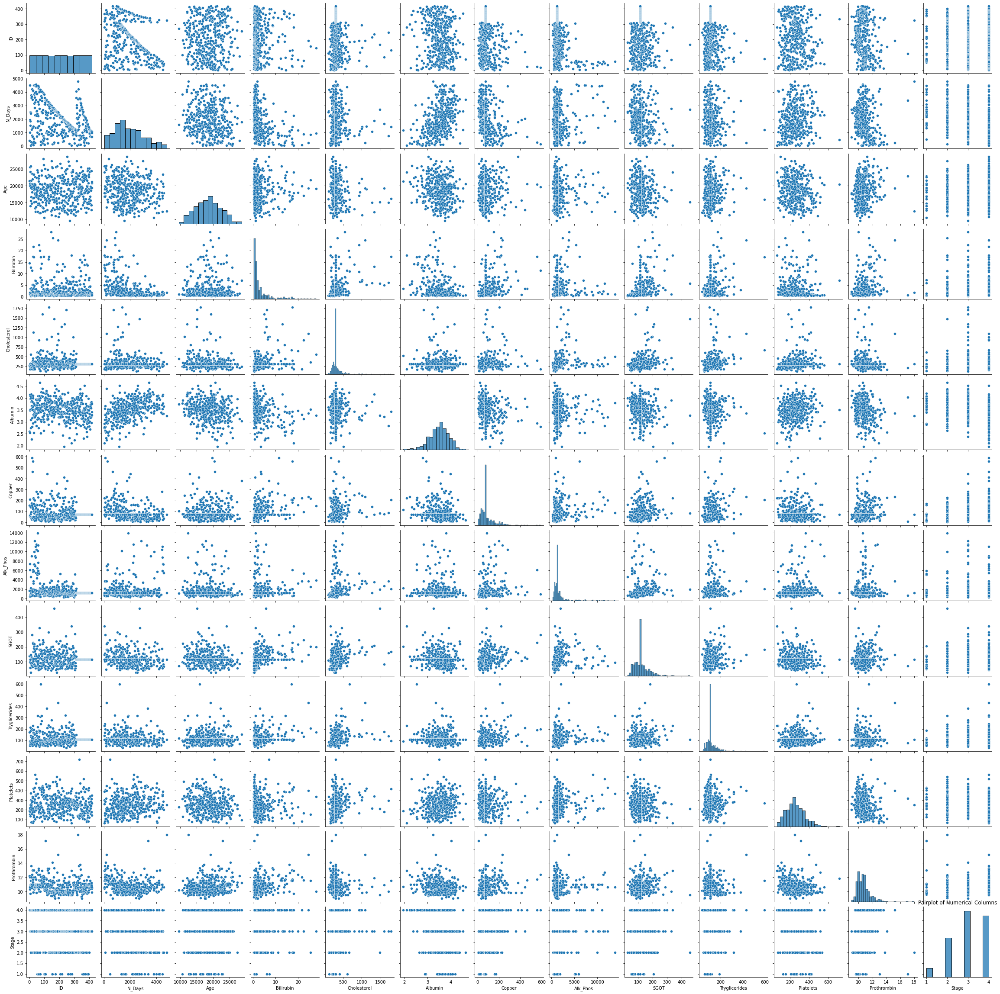

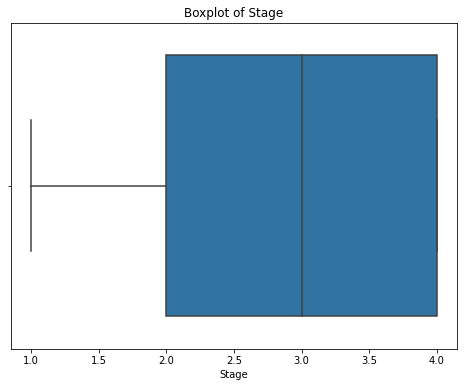

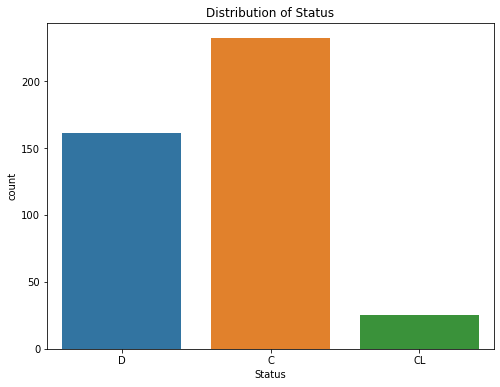

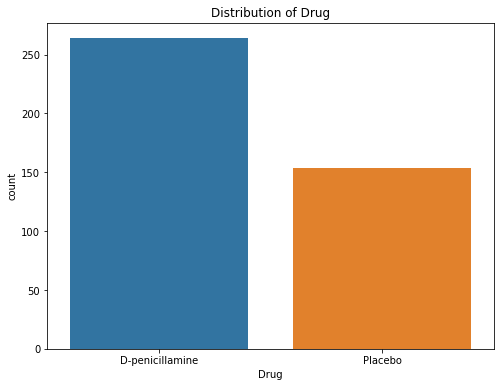

...

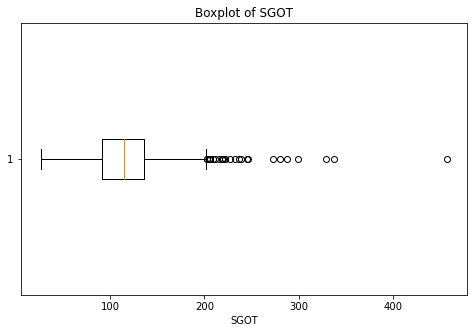

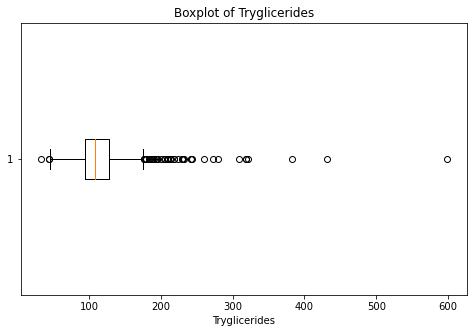

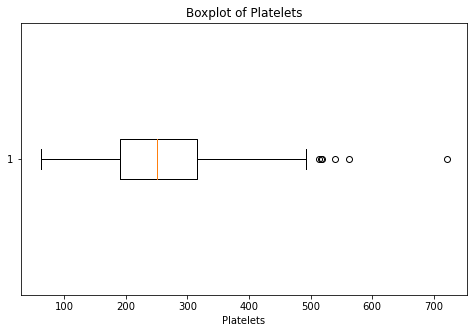

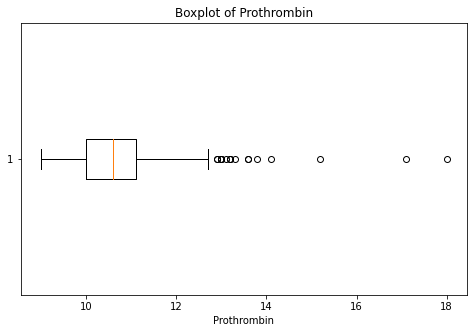

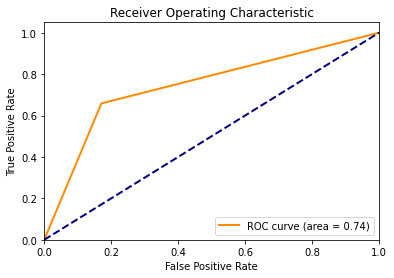

Manual Splitting Test Accuracy: 0.6585365853658537
Classification Report (Manual Splitting):
              precision    recall  f1-score   support

           0       0.68      0.78      0.73        46
           1       0.00      0.00      0.00         4
           2       0.67      0.56      0.61        32

    accuracy                           0.66        82
   macro avg       0.45      0.45      0.45        82
weighted avg       0.64      0.66      0.65        82

ROC AUC (Manual Splitting): 0.7439024390243902

Cross-Validation Mean Accuracy: 0.6180969587473653


In [53]:
# Master function that's controlling pipeline of fucntions
Master()